# Run Dynamo on the data: Pik3ca MG integrated data
[Vignettes](https://dynamo-release.readthedocs.io/en/latest/tutorials/notebooks/zebrafish.html)

## Import

In [1]:
import dynamo as dyn
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import scanpy as sc
from dynamo.configuration import DKM
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", message="numpy.dtype size changed")
dyn.configuration.set_figure_params('dynamo', background='white')
dyn.get_all_dependencies_version()

/home/audrey/anaconda3/envs/dynamo/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/audrey/anaconda3/envs/dynamo/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/home/audrey/anaconda3/envs/dynamo/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_hdf from `anndata` is deprecated. Import anndata.io.read_hdf instead.
  warnings.warn(msg, FutureWarning)
/home/audrey/anaconda3/envs/dynamo/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/home/audrey/anaconda3/envs/dynamo/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Impor

package,umap-learn,typing-extensions,tqdm,statsmodels,setuptools,session-info,seaborn,scipy,pynndescent,pre-commit,pandas,openpyxl,numdifftools,numba,networkx,matplotlib,loompy,leidenalg,igraph,get-version,dynamo-release,colorcet,anndata
version,0.5.7,4.13.2,4.67.1,0.14.4,80.1.0,1.0.1,0.13.2,1.15.2,0.5.13,4.2.0,2.2.3,3.1.5,0.9.41,0.61.2,3.4.2,3.10.3,3.0.8,0.10.2,0.11.8,3.5.5,1.4.1,3.1.0,0.11.4


In [2]:
adata = sc.read_h5ad("../02_Input_merge_and_filteration/merged_Pik.h5ad")

In [3]:
adata

AnnData object with n_obs × n_vars = 16043 × 32285
    obs: 'cell_type', 'umap_1', 'umap_2', 'sample'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [4]:
print(adata.obs[["umap_1", "umap_2"]].head())

                                                umap_1    umap_2
CellID                                                          
possorted_genome_bam_F2ZHW:AAAGGGCTCTGTCAGAx  2.844351  3.001735
possorted_genome_bam_F2ZHW:AAAGTCCAGTGCTCGCx  1.854609 -7.134219
possorted_genome_bam_F2ZHW:AAAGAACTCTAAACGCx -7.574637 -7.710628
possorted_genome_bam_F2ZHW:AAACGAATCAAGTGGGx  7.519389  6.254953
possorted_genome_bam_F2ZHW:AAAGTCCGTACGAGTGx  8.172050  6.475503


In [5]:
# Copy into obsm
adata.obsm["X_umap"] = adata.obs[["umap_1", "umap_2"]].to_numpy()
print(adata.obsm["X_umap"][:5])

[[ 2.84435093  3.00173548]
 [ 1.85460854 -7.13421866]
 [-7.57463706 -7.710628  ]
 [ 7.51938903  6.25495342]
 [ 8.17204988  6.475503  ]]


In [6]:
# Clean-up
adata.obs = adata.obs.drop(columns=["umap_1", "umap_2"])

In [7]:
adata

AnnData object with n_obs × n_vars = 16043 × 32285
    obs: 'cell_type', 'sample'
    obsm: 'X_umap'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

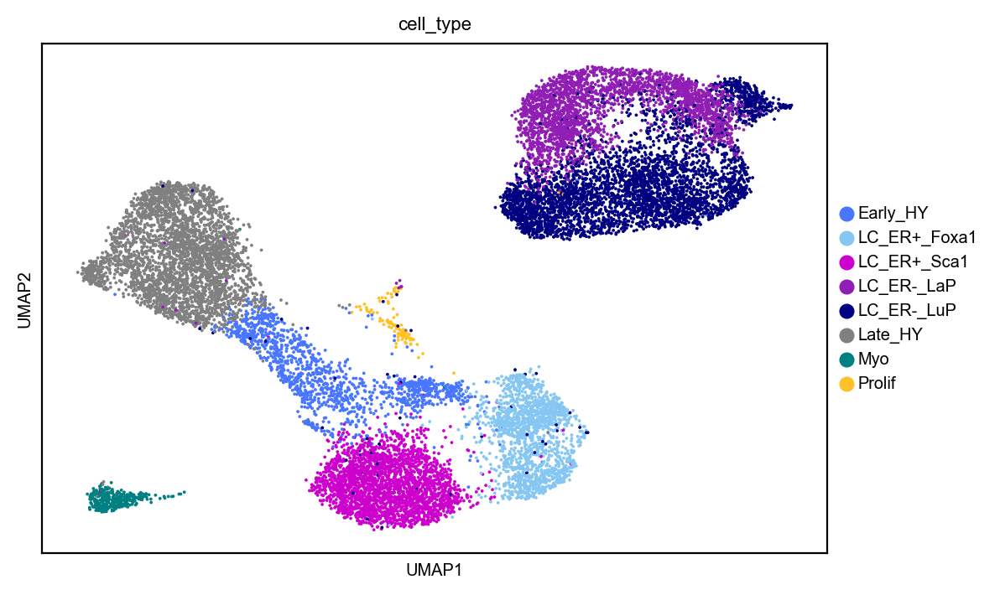

In [8]:
sc.pl.umap(adata, color='cell_type')

In [9]:
# PCA coordinate

from sklearn.decomposition import PCA

In [10]:
# --- 1) Build a normalized/log1p version of the spliced layer (without touching adata.X) ---
# Create normalized spliced layer
sp_norm = sc.pp.normalize_total(
    adata, target_sum=1e4, layer="spliced", inplace=False
)["X"]
# Log1p
sp_log = sc.pp.log1p(adata, layer=None, copy=True)  # quick way to get a log1p function
# but we actually apply log1p ourselves to the normalized matrix:
sp_log = np.log1p(sp_norm)
adata.layers["spliced_log1p"] = sp_log  # keep it explicit

In [11]:
# --- 2) PCA on the log-normalized spliced layer ---
n_pcs = 50
pca = PCA(n_components=n_pcs, svd_solver="arpack")
X_pca = pca.fit_transform(adata.layers["spliced_log1p"])
adata.obsm["X_pca"] = X_pca
adata.uns["pca"] = {
    "variance_ratio": pca.explained_variance_ratio_,
    "variance": pca.explained_variance_,
}

# (Optional) if you want neighbors/KNN built on PCA (helps downstream):
sc.pp.neighbors(adata, use_rep="X_pca", n_neighbors=30, n_pcs=n_pcs)

In [12]:
# Proliferating cell filteration
# Check how many Prolif cells you have
print((adata.obs["cell_type"] == "Prolif").sum())

110


In [13]:
adata = adata[adata.obs["cell_type"] != "Prolif"].copy()

In [14]:
print(adata.obs["cell_type"].unique())

['LC_ER-_LuP', 'LC_ER+_Foxa1', 'Myo', 'LC_ER-_LaP', 'LC_ER+_Sca1', 'Late_HY', 'Early_HY']
Categories (7, object): ['Early_HY', 'LC_ER+_Foxa1', 'LC_ER+_Sca1', 'LC_ER-_LaP', 'LC_ER-_LuP', 'Late_HY', 'Myo']


In [15]:
celltype_colors = {
    "Late_HY": "#32CD32",      
    "LC_ER+_Sca1": "#800000",       
    "LC_ER+_Foxa1": "#F08080",
    "LC_ER-_LuP": "#FFA500", 
    "LC_ER-_LaP": "#2F4F4F",
    "Early_HY": "#BDB76B",
    "Myo": "#1E90FF"
}

# Apply colors to AnnData object
adata.uns["cell_type_colors"] = [
    celltype_colors[ct] for ct in adata.obs["cell_type"].cat.categories
]

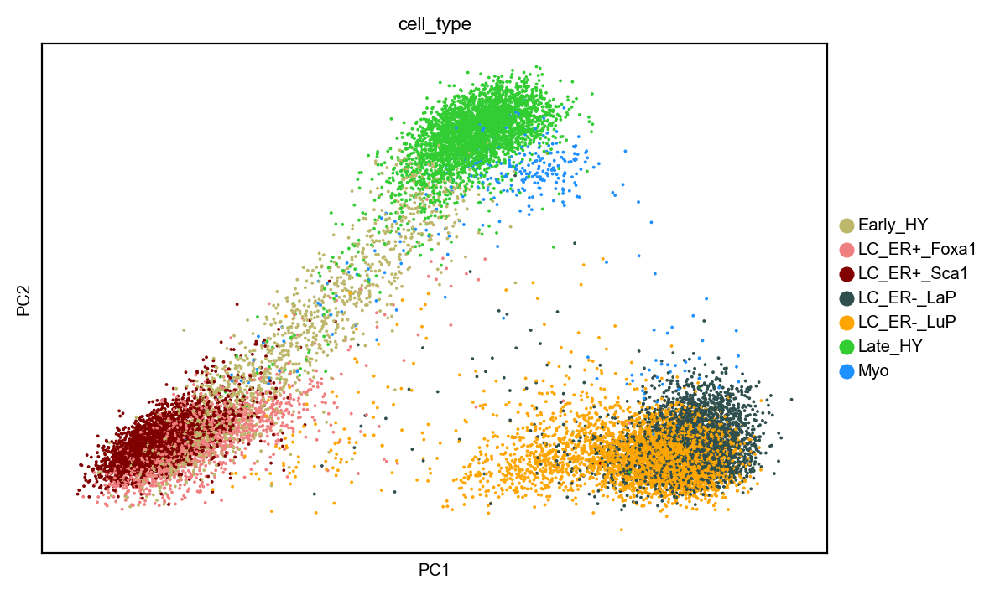

In [16]:
sc.pl.pca(adata, color='cell_type')

## Preprocessing with monocle method

In [17]:
preprocessor = dyn.pp.Preprocessor(cell_cycle_score_enable=True)
preprocessor.preprocess_adata(adata, recipe='monocle')

|-----> Running monocle preprocessing pipeline...
|-----------> filtered out 0 outlier cells
|-----------> filtered out 22908 outlier genes
|-----> PCA dimension reduction
|-----> <insert> X_pca to obsm in AnnData Object.
|-----> computing cell phase...
|-----? 
Dynamo is not able to perform cell cycle staging for you automatically. 
Since dyn.pl.phase_diagram in dynamo by default colors cells by its cell-cycle stage, 
you need to set color argument accordingly if confronting errors related to this.
|-----> [Preprocessor-monocle] completed [80.8401s]


In [18]:
adata

AnnData object with n_obs × n_vars = 15933 × 32285
    obs: 'cell_type', 'sample', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_log1p_Size_Factor', 'initial_spliced_log1p_cell_size', 'ntr'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean'
    obsm: 'X_umap', 'X_pca'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced', 'spliced_log1p', 'X_spliced_log1p', 'X_spliced', 'X_unspliced'
    obsp: 'distances', 'connectivities'

## RNA velocity with parallelism

In [19]:
dyn.tl.dynamics(adata, model='stochastic', cores=4) 

|-----> dynamics_del_2nd_moments_key is None. Using default value from DynamoAdataConfig: dynamics_del_2nd_moments_key=False
|-----------> removing existing M layers:[]...
|-----------> making adata smooth...
|-----> calculating first/second moments...
|-----? layer X_spliced_log1p is not in any of the (['X_spliced', 'X_unspliced'], ['X_new', 'X_total'], ['X_uu', 'X_ul', 'X_su', 'X_sl']) groups, skipping...
|-----? layer X_spliced_log1p is not in any of the (['X_spliced', 'X_unspliced'], ['X_new', 'X_total'], ['X_uu', 'X_ul', 'X_su', 'X_sl']) groups, skipping...
|-----> [moments calculation] completed [48.0397s]


AnnData object with n_obs × n_vars = 15933 × 32285
    obs: 'cell_type', 'sample', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_log1p_Size_Factor', 'initial_spliced_log1p_cell_size', 'ntr'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'vel_params_names', 'dynamics'
    obsm: 'X_umap', 'X_pca'
    varm: 'vel_params'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced', 'spliced_log1p', 'X_spliced_log1p', 'X_spliced', 'X_unspliced', 'M_u', 'M_uu', 'M_s', 'M_us', 'M_ss', 'velocity_S'
    obsp: 'distances', 'connectivities', 'moments_con'

In [20]:
dyn.tl.reduceDimension(adata, basis="pca")

|-----> retrieve data for non-linear dimension reduction...
|-----? adata already have basis umap. dimension reduction umap will be skipped! 
set enforce=True to re-performing dimension reduction.
|-----> [UMAP] completed [0.0020s]


|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


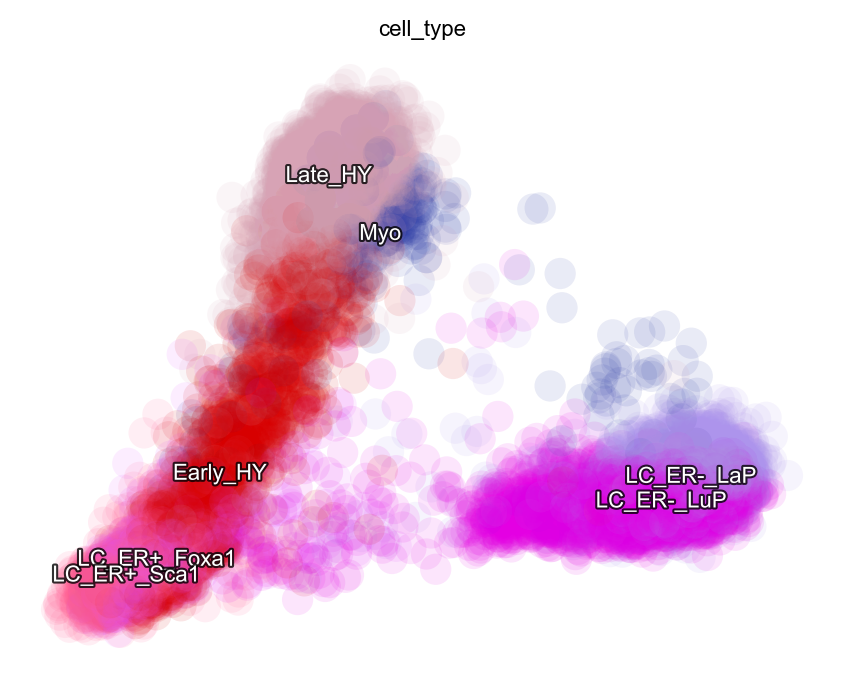

In [21]:
dyn.pl.pca(adata, color='cell_type',
           save_show_or_return='show')

In [22]:
adata.obs["cell_type"]

CellID
possorted_genome_bam_F2ZHW:AAAGGGCTCTGTCAGAx      LC_ER-_LuP
possorted_genome_bam_F2ZHW:AAAGTCCAGTGCTCGCx    LC_ER+_Foxa1
possorted_genome_bam_F2ZHW:AAAGAACTCTAAACGCx             Myo
possorted_genome_bam_F2ZHW:AAACGAATCAAGTGGGx      LC_ER-_LuP
possorted_genome_bam_F2ZHW:AAAGTCCGTACGAGTGx      LC_ER-_LuP
                                                    ...     
possorted_genome_bam_Q7E7W:TTTGGTTAGGGATGTCx      LC_ER-_LaP
possorted_genome_bam_Q7E7W:TTTGTTGCATATGGCTx      LC_ER-_LaP
possorted_genome_bam_Q7E7W:TTTGTTGTCGTTGCCTx      LC_ER-_LuP
possorted_genome_bam_Q7E7W:TTTGTTGGTTTCGCTCx      LC_ER-_LuP
possorted_genome_bam_Q7E7W:TTTGTTGTCTCACTCGx      LC_ER-_LaP
Name: cell_type, Length: 15933, dtype: category
Categories (7, object): ['Early_HY', 'LC_ER+_Foxa1', 'LC_ER+_Sca1', 'LC_ER-_LaP', 'LC_ER-_LuP', 'Late_HY', 'Myo']

In [23]:
dyn.tl.gene_wise_confidence(adata, group='cell_type', lineage_dict={'LC_ER+_Foxa1': ['Myo'], 'LC_ER+_Sca1': ['Myo']})

calculating gene velocity vectors confidence based on phase portrait location with priors of progenitor/mature cell types: 2000it [02:20, 14.22it/s]


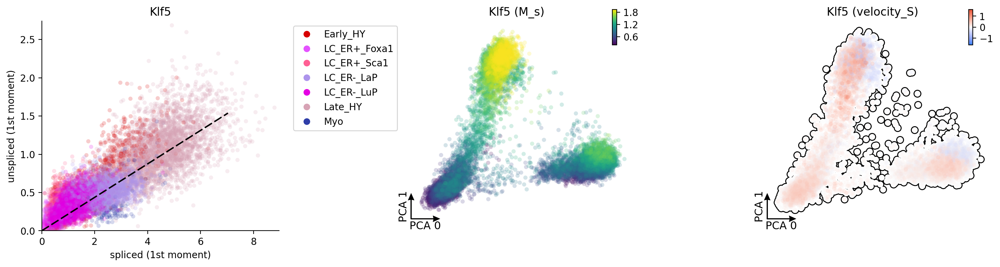

In [24]:
dyn.pl.phase_portraits(adata, genes="Klf5", 
                       figsize=(6, 4), color='cell_type', basis="pca")

In [26]:
cats = list(adata.obs["cell_type"].cat.categories)
color_key = {ct: celltype_colors[ct] for ct in cats if ct in celltype_colors}

color_key

{'Early_HY': '#BDB76B',
 'LC_ER+_Foxa1': '#F08080',
 'LC_ER+_Sca1': '#800000',
 'LC_ER-_LaP': '#2F4F4F',
 'LC_ER-_LuP': '#FFA500',
 'Late_HY': '#32CD32',
 'Myo': '#1E90FF'}

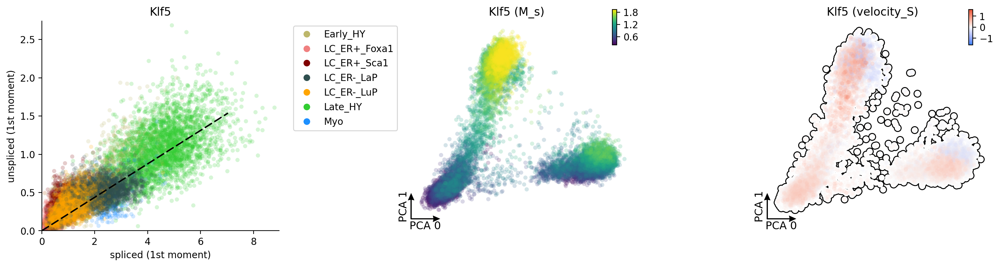

In [27]:
dyn.pl.phase_portraits(
    adata,
    genes="Klf5",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    save_show_or_return = "return",
    #save_kwargs={"path": "./", "prefix": "Klf5_phase", "dpi": 300, "ext": "pdf"}
)

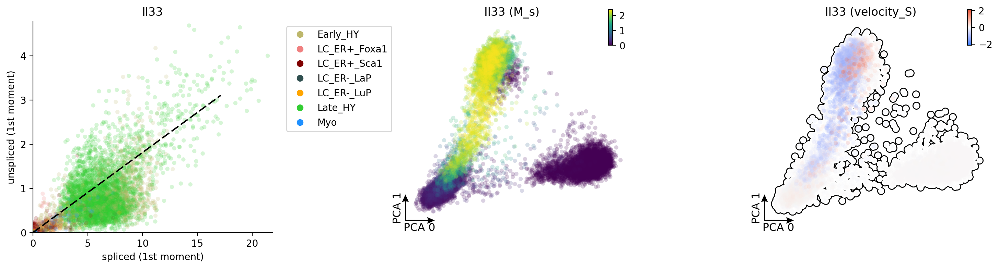

In [28]:
dyn.pl.phase_portraits(
    adata,
    genes="Il33",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    save_show_or_return = "return",
    #save_kwargs={"path": "./", "prefix": "Il33_phase", "dpi": 300, "ext": "pdf"}
)

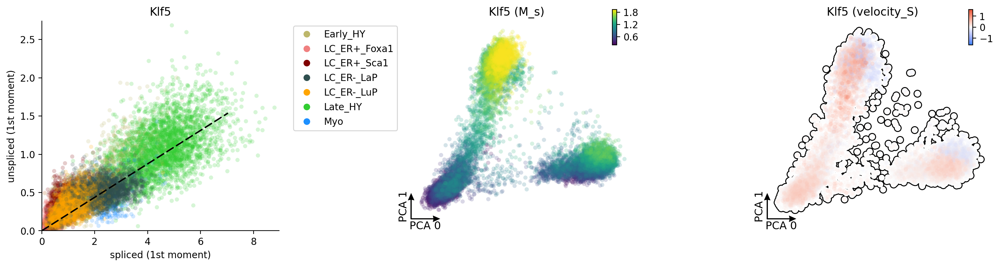

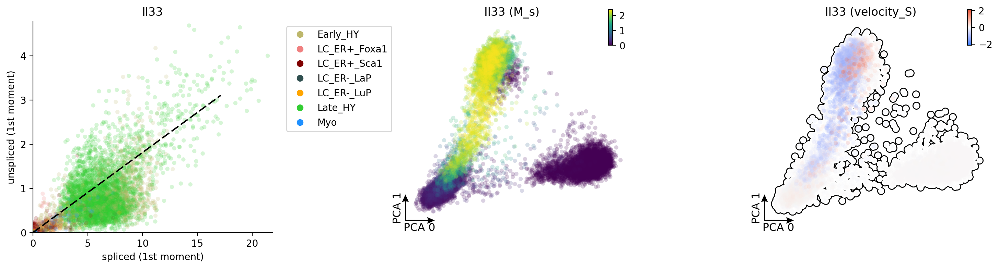

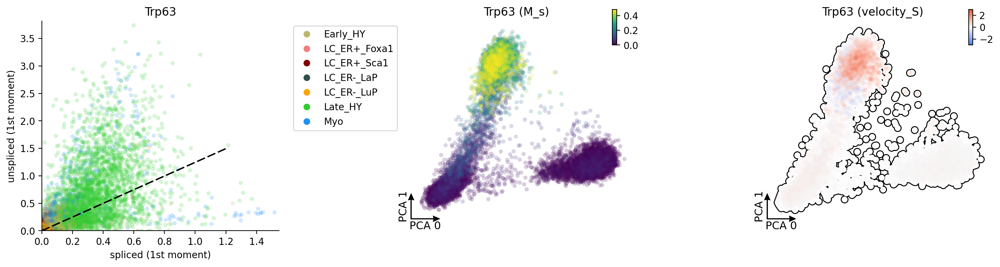

In [29]:
dyn.pl.phase_portraits(
    adata,
    genes="Trp63",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    #save_show_or_return = "save",
    #save_kwargs={"path": "./", "prefix": "Il33_phase", "dpi": 300, "ext": "pdf"}
)

# Velocity projection

In [30]:
dyn.tl.cell_velocities(adata, method='pearson', other_kernels_dict={'transform': 'sqrt'}, basis="pca")

|-----> [calculating transition matrix via pearson kernel with sqrt transform.] in progress: 100.0000%|-----> [calculating transition matrix via pearson kernel with sqrt transform.] completed [63.1845s]
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [4.8097s]
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


AnnData object with n_obs × n_vars = 15933 × 32285
    obs: 'cell_type', 'sample', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_log1p_Size_Factor', 'initial_spliced_log1p_cell_size', 'ntr'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'avg_prog_confidence', 'avg_mature_confidence', 'use_for_transition'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'vel_params_names', 'dynamics', 'gene_wise_confidence', 'grid_velocity_pca'
    obsm: 'X_umap', 'X_pca', 'velocity_pca'
    varm: 'vel_params'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced', 'spliced_log1p', 'X_spliced_log1p', 'X_spliced', 'X_unspliced', 'M_u', 'M_uu', 'M_s', 'M_us', 'M_ss', 'velocity_

In [31]:
dyn.tl.cell_wise_confidence(adata)

|-----> incomplete neighbor graph info detected: connectivities and distances do not exist in adata.obsp, indices not in adata.uns.neighbors.
|-----> Neighbor graph is broken, recomputing....
|-----> Start computing neighbor graph...
|-----------> X_data is None, fetching or recomputing...
|-----> fetching X data from layer:None, basis:pca
|-----> method arg is None, choosing methods automatically...
|-----------> method pynn selected


AnnData object with n_obs × n_vars = 15933 × 32285
    obs: 'cell_type', 'sample', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_log1p_Size_Factor', 'initial_spliced_log1p_cell_size', 'ntr', 'jaccard_velocity_confidence'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'avg_prog_confidence', 'avg_mature_confidence', 'use_for_transition'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'vel_params_names', 'dynamics', 'gene_wise_confidence', 'grid_velocity_pca'
    obsm: 'X_umap', 'X_pca', 'velocity_pca'
    varm: 'vel_params'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced', 'spliced_log1p', 'X_spliced_log1p', 'X_spliced', 'X_unspliced', 'M_u', 'M_uu', 'M

In [32]:
dyn.tl.confident_cell_velocities(adata, group='cell_type', 
                                 lineage_dict={'LC_ER+_Foxa1': ['Myo'], 'LC_ER+_Sca1': ['Myo']}, basis="pca")

calculating gene velocity vectors confidence based on phase portrait location with priors of progenitor/mature cell types: 2000it [02:21, 14.13it/s]


|-----> [calculating transition matrix via pearson kernel with sqrt transform.] in progress: 100.0000%|-----> [calculating transition matrix via pearson kernel with sqrt transform.] completed [20.6620s]
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [4.9611s]
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


AnnData object with n_obs × n_vars = 15933 × 32285
    obs: 'cell_type', 'sample', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_log1p_Size_Factor', 'initial_spliced_log1p_cell_size', 'ntr', 'jaccard_velocity_confidence'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'avg_prog_confidence', 'avg_mature_confidence', 'use_for_transition', 'avg_confidence', 'confident_genes'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'vel_params_names', 'dynamics', 'gene_wise_confidence', 'grid_velocity_pca'
    obsm: 'X_umap', 'X_pca', 'velocity_pca'
    varm: 'vel_params'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced', 'spliced_log1p', 'X_spliced_log1p', 'X_splic

|-----> X shape: (15933, 2) V shape: (15933, 2)
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


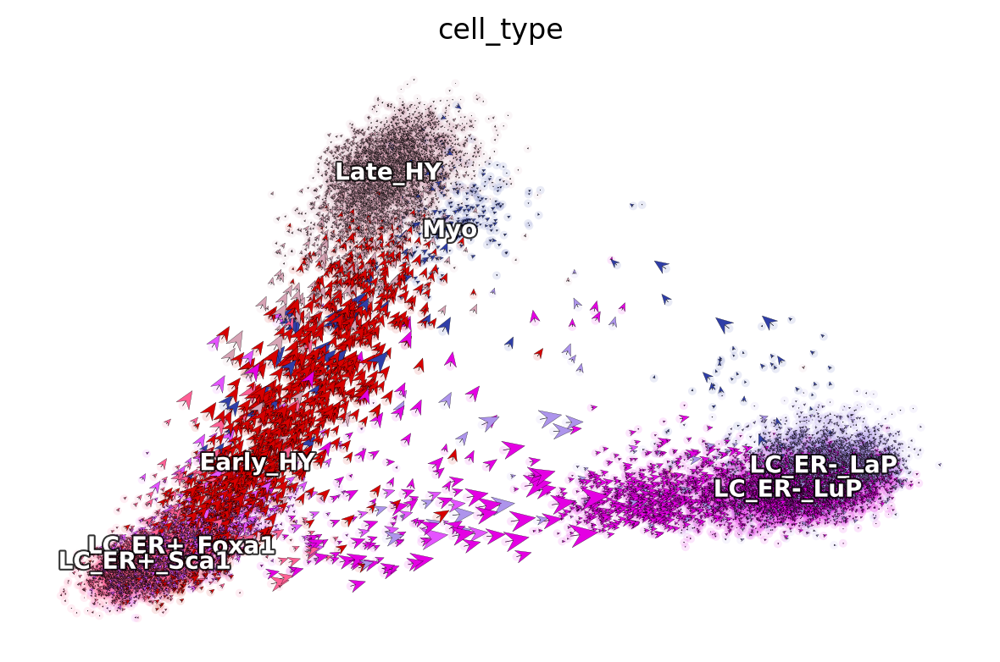

In [33]:
dyn.pl.cell_wise_vectors(adata, color=['cell_type'], basis='pca', 
                         show_legend='on data', quiver_length=6, 
                         quiver_size=6, pointsize=0.1, 
                         show_arrowed_spines=False)

|-----> X shape: (15933, 2) V shape: (15933, 2)
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


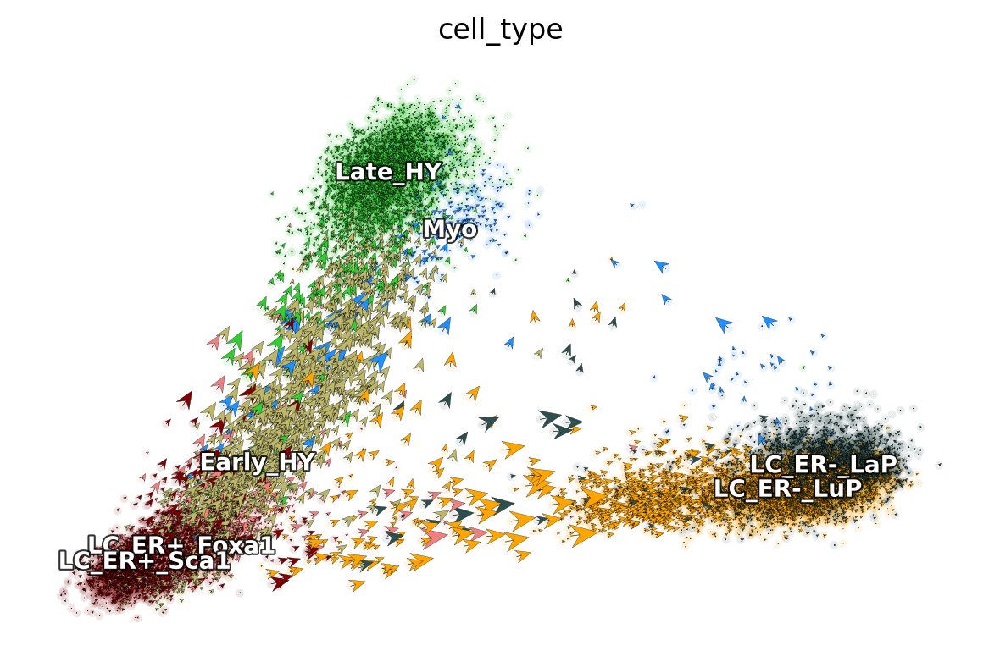

In [34]:
# Make sure your mapping matches categories
cats = list(adata.obs["cell_type"].cat.categories)
color_key = {ct: celltype_colors[ct] for ct in cats if ct in celltype_colors}

dyn.pl.cell_wise_vectors(
    adata,
    color="cell_type",
    basis="pca",
    show_legend="on data",
    quiver_length=6,
    quiver_size=6,
    pointsize=0.1,
    show_arrowed_spines=False,
    background="white",
    color_key=color_key        # <--- use this instead
)

|-----> X shape: (15933, 2) V shape: (15933, 2)
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


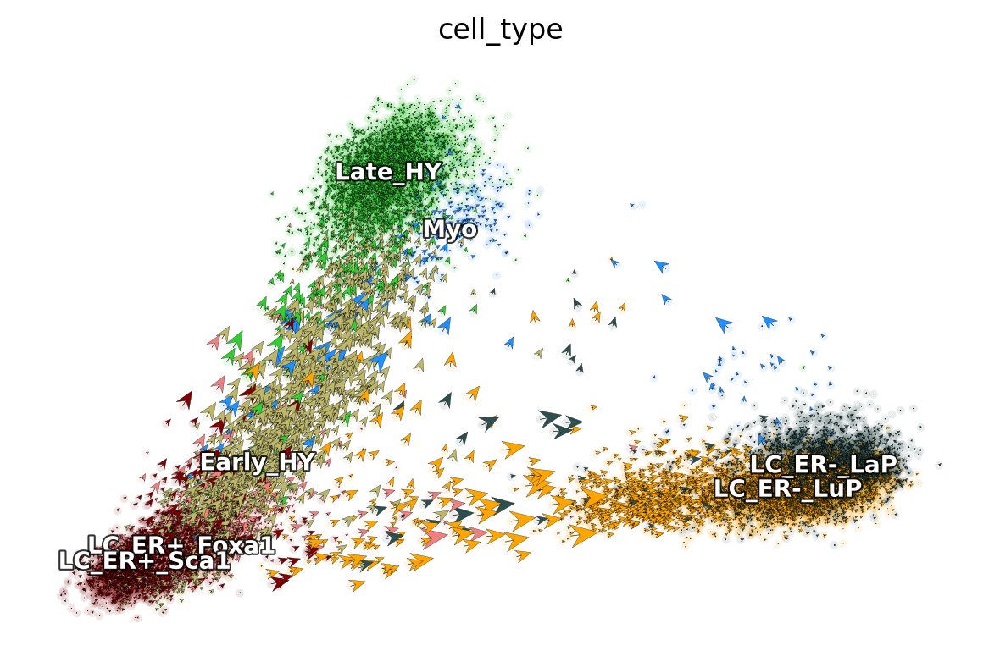

In [38]:
dyn.pl.cell_wise_vectors(
    adata,
    color="cell_type",
    basis="pca",
    show_legend="on data",
    quiver_length=6,
    quiver_size=6,
    pointsize=0.1,
    show_arrowed_spines=False,
    background="white",
    color_key=color_key,
    save_show_or_return="show",   # <--- tell Dynamo to save
    #save_kwargs={
     #   "path": "./",             # directory
      #  "prefix": "cellwise_vec", # filename prefix
       # "dpi": 300,
        #"ext": "pdf"              # file extension
    #}
)

|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


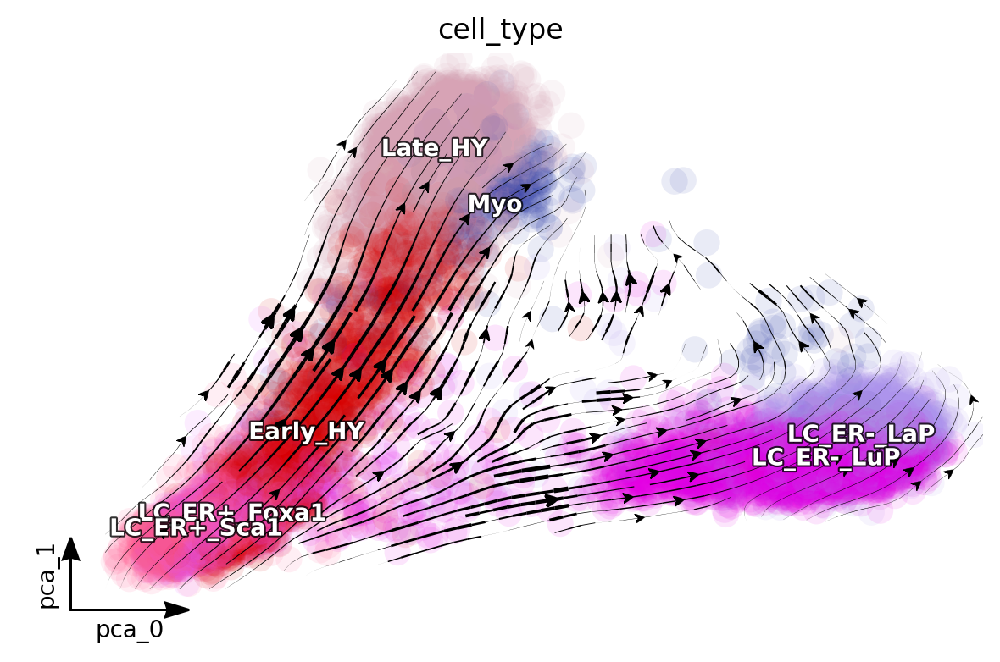

In [39]:
dyn.pl.streamline_plot(adata, color=['cell_type'], 
                       basis='pca', show_legend='on data', 
                       show_arrowed_spines=True)

In [30]:
#adata.write('Dynamo_result_embedded_Pik3ca_PCA.h5ad')

## Reconstruct vector field

In [40]:
# you can set `verbose = 1/2/3` to obtain different levels of running information of vector field reconstruction
dyn.vf.VectorField(adata, basis='pca', M=1000, pot_curl_div=True) 

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> method arg is None, choosing methods automatically...
|-----------> method ball_tree selected
|-----> [SparseVFC] completed [2.4306s]
|-----> Running ddhodge to estimate vector field based pseudotime in pca basis...
|-----> graphizing vectorfield...
|-----------> calculating neighbor indices...
|-----> method arg is None, choosing methods automatically...
|-----------> method ball_tree selected
|-----------> not all cells are used, set diag to 1...
|-----------> Constructing W matrix according upsampling=True and downsampling=True options...
|-----> [ddhodge completed] completed [27.7659s]
|-----> Computing divergence...


Calculating divergence: 100%|███████████████████| 16/16 [00:04<00:00,  3.70it/s]


|-----> [VectorField] completed [35.3416s]


In [41]:
adata

AnnData object with n_obs × n_vars = 15933 × 32285
    obs: 'cell_type', 'sample', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_log1p_Size_Factor', 'initial_spliced_log1p_cell_size', 'ntr', 'jaccard_velocity_confidence', 'pca_ddhodge_sampled', 'pca_ddhodge_div', 'pca_potential', 'pca_ddhodge_potential', 'divergence_pca', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'avg_prog_confidence', 'avg_mature_confidence', 'use_for_transition', 'avg_confidence', 'confident_genes'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'vel_params_names', 'dynamics', 'gene_wise_confidence', 'grid_velocity_pca', 'VecFld

|-----------> plotting with basis key=X_pca


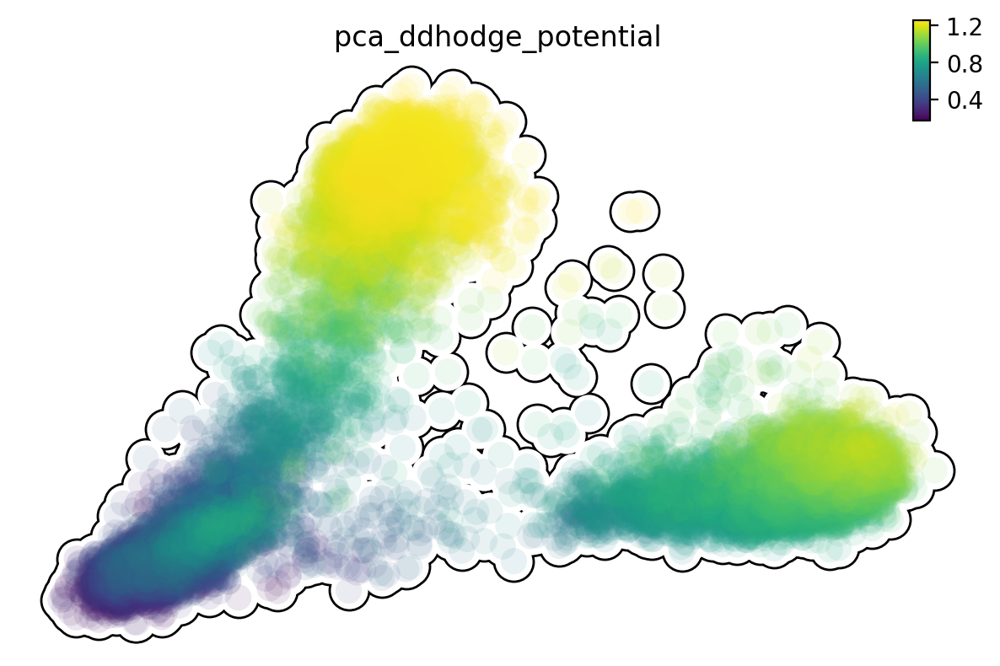

In [42]:
dyn.pl.pca(adata,  color='pca_ddhodge_potential', frontier=True)

|-----------> plotting with basis key=X_pca


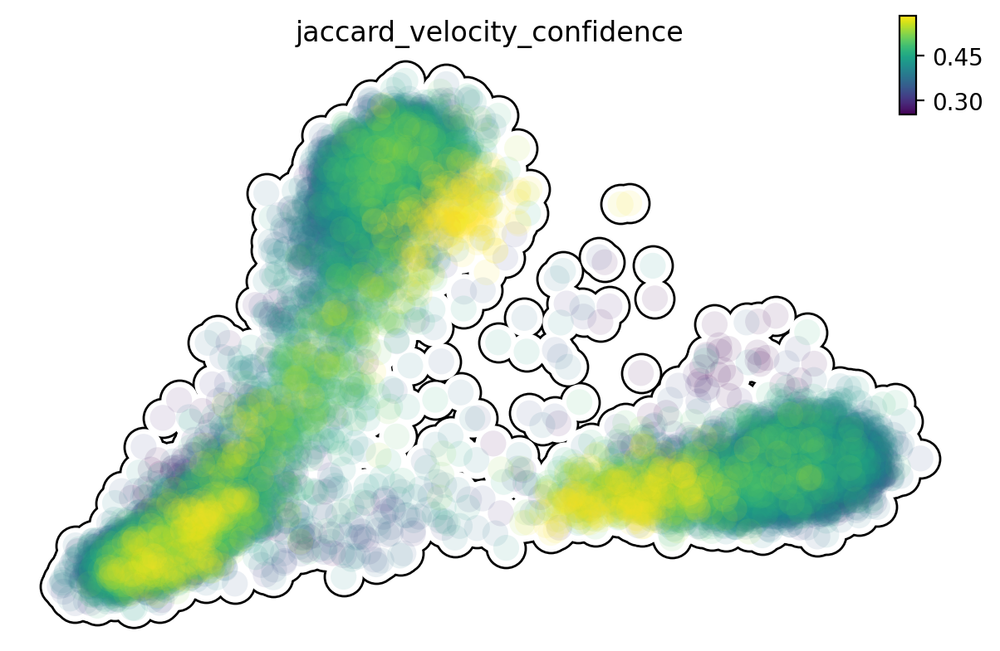

In [43]:
dyn.pl.pca(adata,  color='jaccard_velocity_confidence', frontier=True)

|-----------> plotting with basis key=X_pca


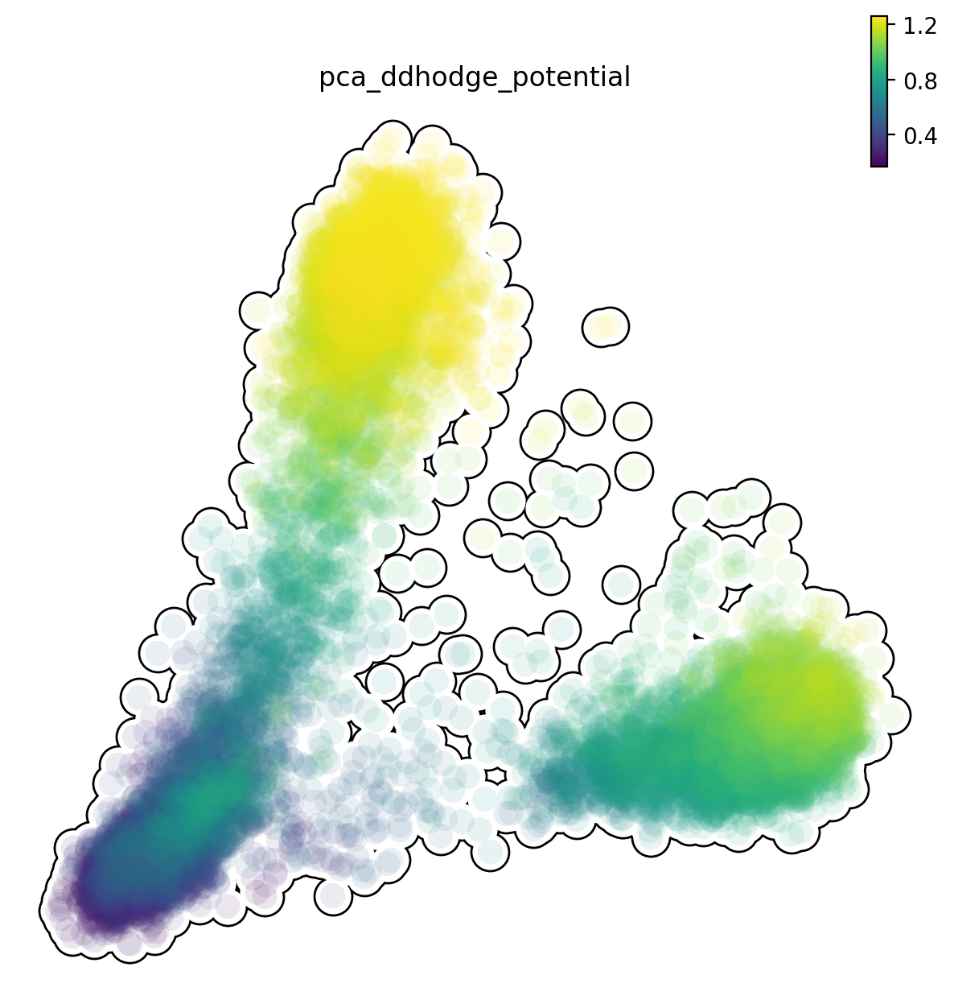

In [46]:
dyn.pl.pca(
    adata,
    color="pca_ddhodge_potential",
    frontier=True,
    figsize=(6, 6),
    save_show_or_return="show",
    #save_kwargs={"path": "./", "prefix": "pca_ddhodge_", "ext": "pdf"}
)

|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type
|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type
|-----------> plotting with basis key=X_pca
|-----------> skip filteri

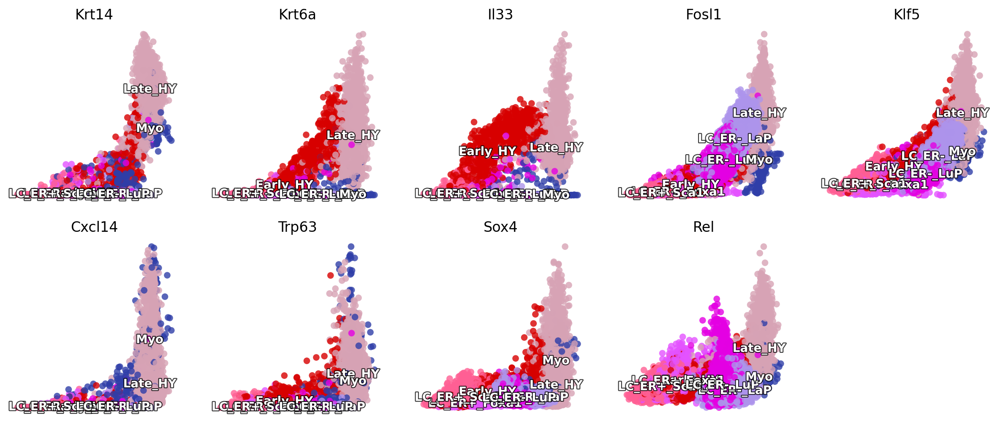

In [50]:
import numpy as np 
import matplotlib.pyplot as plt

fig3_si5 = ['Krt14', "Krt6a", "Il33", "Fosl1", "Klf5", "Cxcl14", "Trp63", "Sox4", "Rel", "Wnt10a"]

fig,axes=plt.subplots(2,5,figsize = (15,6))
for i,(ax,gene) in enumerate(zip(axes.flatten(),fig3_si5)):
    ax=dyn.pl.scatters(adata, x='pca_ddhodge_potential', 
                    pointsize=0.25, alpha=0.8, y=gene, layer='X_spliced', color='cell_type',
                    background='white', ax=ax, basis="pca",
                    save_show_or_return='return',show_legend='on data',)
fig.delaxes(axes[1, 4])   
plt.show()

|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


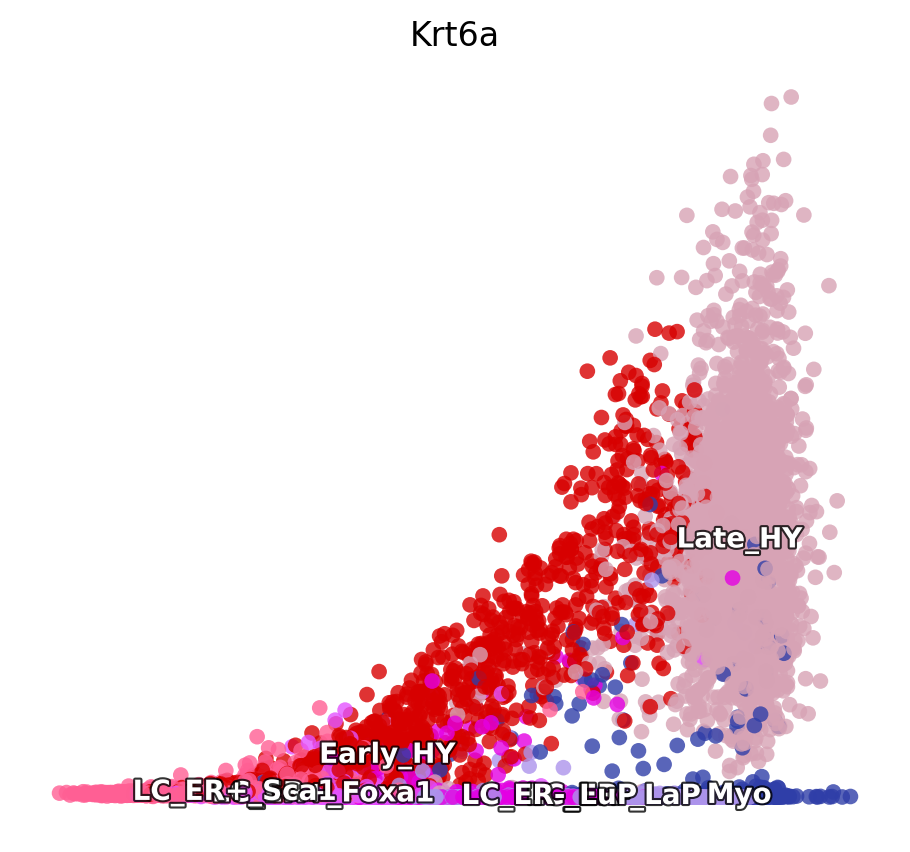

In [51]:
fig, ax = plt.subplots(figsize=(6, 5))
dyn.pl.scatters(
    adata,
    x="pca_ddhodge_potential",
    y="Krt6a",                # <--- single gene here
    layer="X_spliced",
    color="cell_type",
    pointsize=0.25,
    alpha=0.8,
    basis="pca",
    background="white",
    ax=ax,
    show_legend="on data",
    save_show_or_return="show"
)

#fig.savefig("Klf5_scatter.pdf", bbox_inches="tight", dpi=300)
plt.show()

|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


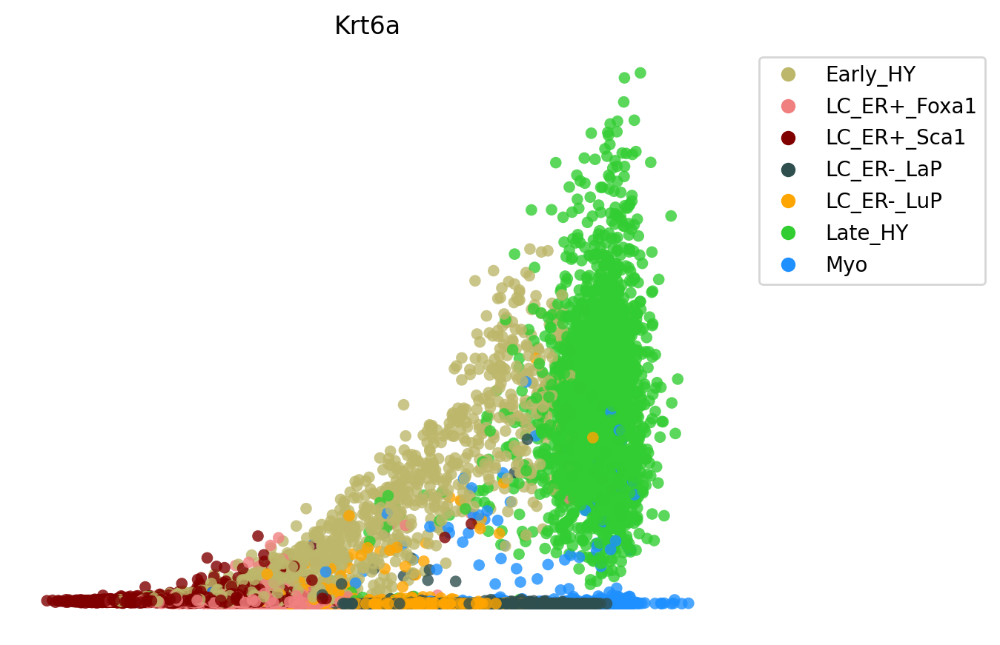

In [52]:
# build dict with only categories that exist in your data
cats = list(adata.obs["cell_type"].cat.categories)
color_key = {ct: celltype_colors[ct] for ct in cats if ct in celltype_colors}

fig, ax = plt.subplots(figsize=(6, 5))
dyn.pl.scatters(
    adata,
    x="pca_ddhodge_potential",
    y="Krt6a",                # single gene
    layer="X_spliced",
    color="cell_type",
    pointsize=0.25,
    alpha=0.8,
    basis="pca",
    background="white",
    ax=ax,
    show_legend="None",
    save_show_or_return="show",
    color_key=color_key       # <--- apply your custom colors here
)

#fig.savefig("Krt6a_scatter_customcolor.pdf", bbox_inches="tight", dpi=300)
plt.show()

In [85]:
#adata.write('Dynamo_result_embedded_Pik3ca_PCA.h5ad')

## Beyond RNA velocity

In [53]:
adata

AnnData object with n_obs × n_vars = 15933 × 32285
    obs: 'cell_type', 'sample', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_log1p_Size_Factor', 'initial_spliced_log1p_cell_size', 'ntr', 'jaccard_velocity_confidence', 'pca_ddhodge_sampled', 'pca_ddhodge_div', 'pca_potential', 'pca_ddhodge_potential', 'divergence_pca', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'avg_prog_confidence', 'avg_mature_confidence', 'use_for_transition', 'avg_confidence', 'confident_genes'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'vel_params_names', 'dynamics', 'gene_wise_confidence', 'grid_velocity_pca', 'VecFld

In [54]:
n_pcs = adata.uns['PCs'].shape[1]   # e.g., 30
n_pcs

30

In [55]:
# --- 1) Clean conflicting fields (optional but safer) ---
for k in ['VecFld_pca', 'speed_pca', 'curl_pca', 'divergence_pca']:
    if k in adata.uns:  del adata.uns[k]
    if k in adata.obsm: del adata.obsm[k]
    if k in adata.obs:  del adata.obs[k]

In [56]:
dyn.tl.cell_velocities(adata, basis='pca')

Using existing pearson_transition_matrix found in .obsp.
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [4.8951s]
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


AnnData object with n_obs × n_vars = 15933 × 32285
    obs: 'cell_type', 'sample', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_log1p_Size_Factor', 'initial_spliced_log1p_cell_size', 'ntr', 'jaccard_velocity_confidence', 'pca_ddhodge_sampled', 'pca_ddhodge_div', 'pca_potential', 'pca_ddhodge_potential', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'avg_prog_confidence', 'avg_mature_confidence', 'use_for_transition', 'avg_confidence', 'confident_genes'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'vel_params_names', 'dynamics', 'gene_wise_confidence', 'grid_velocity_pca', 'Krt14_colors', 'Krt6a_co

In [57]:
# --- 2) 3D VF for curl/divergence ---
dyn.vf.VectorField(adata, basis='pca', dims=3)
dyn.vf.speed(adata, basis='pca')             # recompute on this VF
dyn.vf.curl(adata, basis='pca')     # no dim1/2/3 needed now
dyn.vf.divergence(adata, basis='pca')

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [SparseVFC] completed [8.8513s]
|-----> [VectorField] completed [9.4467s]


Calculating divergence: 100%|███████████████████| 16/16 [00:01<00:00, 13.68it/s]


In [58]:
adata.uns['PCs_3'] = adata.uns['PCs'][:, :3] 

In [59]:
dyn.vf.acceleration(adata, basis='pca', Qkey='PCs_3')

|-----> [Calculating acceleration] in progress: 100.0000%|-----> [Calculating acceleration] completed [0.2216s]


In [60]:
dyn.vf.curvature(adata, basis='pca', Qkey='PCs_3')

|-----> [Calculating acceleration] in progress: 100.0000%|-----> [Calculating acceleration] completed [0.2277s]
|-----> [Calculating curvature] in progress: 100.0000%|-----> [Calculating curvature] completed [0.3443s]


|-----> X shape: (15933, 2) V shape: (15933, 2)
|-----------> plotting with basis key=X_pca
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> plotting with basis key=X_pca
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> plotting with basis key=X_pca
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> plotting with basis key=X_pca


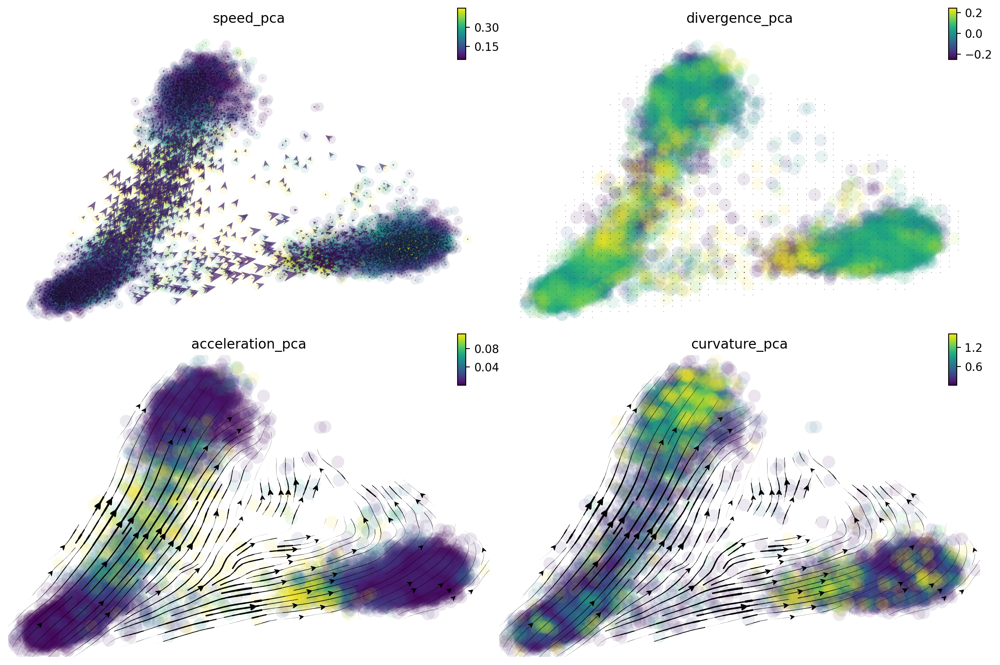

In [61]:
import matplotlib.pyplot as plt

fig1, f1_axes = plt.subplots(ncols=2, nrows=2, constrained_layout=True, figsize=(12, 8))
dyn.pl.cell_wise_vectors(adata, color='speed_pca', basis="pca",
                        pointsize=0.5, alpha = 0.7, ax=f1_axes[0, 0],
                        quiver_length=6, quiver_size=6, save_show_or_return='return')
dyn.pl.grid_vectors(adata, color='divergence_pca', basis="pca",
                    ax=f1_axes[0, 1], quiver_length=12, quiver_size=12, save_show_or_return='return')
dyn.pl.streamline_plot(adata, color='acceleration_pca', basis="pca",
                       ax=f1_axes[1, 0], save_show_or_return='return')
dyn.pl.streamline_plot(adata, color='curvature_pca', basis="pca",
                       ax=f1_axes[1, 1], save_show_or_return='return')
fig1

|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> plotting with basis key=X_pca


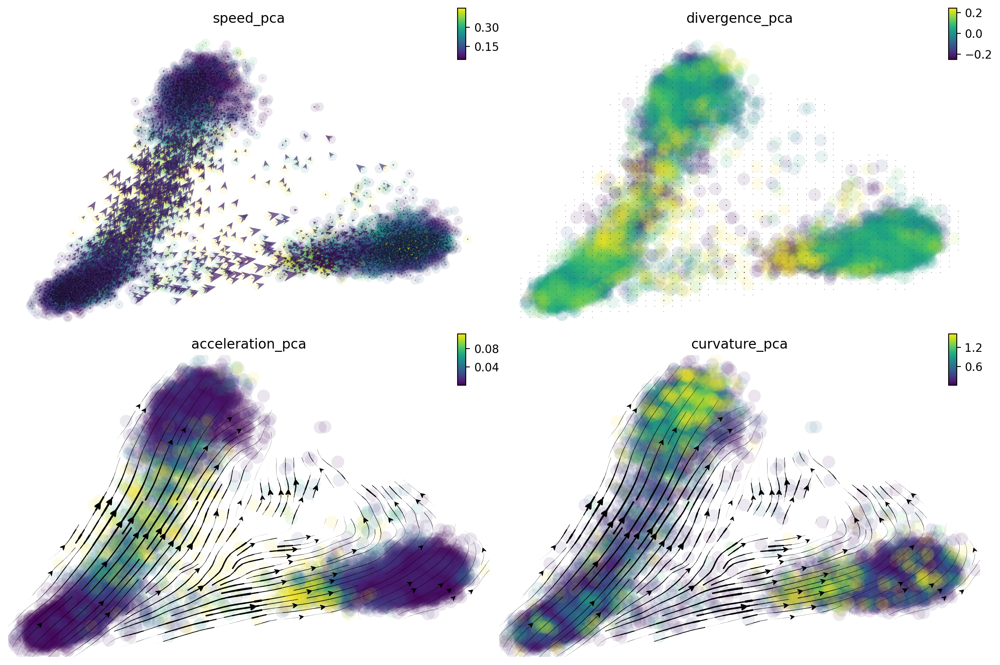

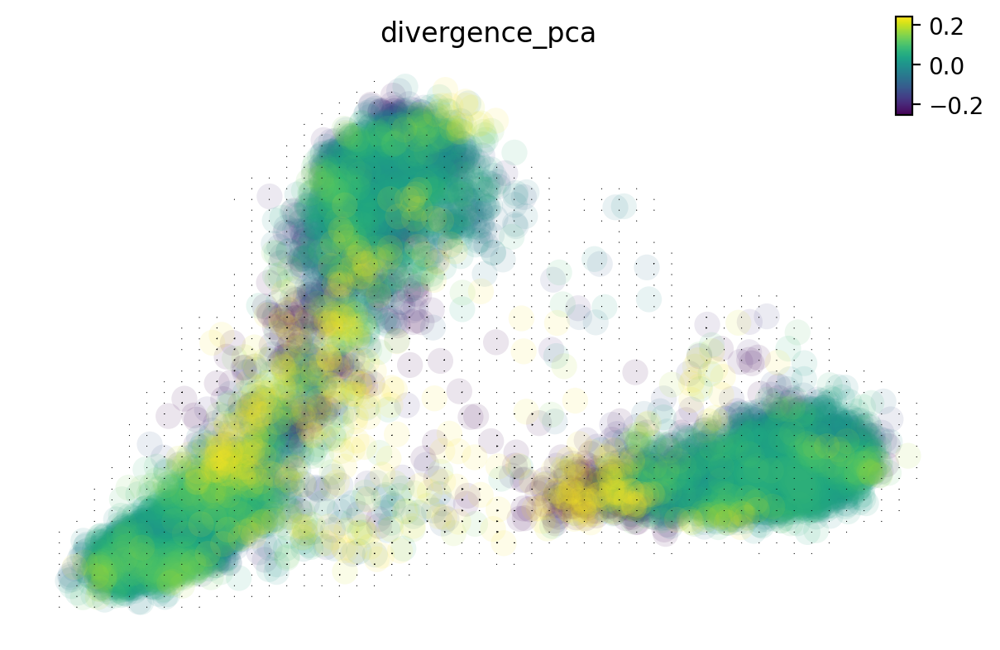

In [62]:
dyn.pl.grid_vectors(
    adata,
    color="divergence_pca",
    basis="pca",
    quiver_length=12,
    quiver_size=12,
    background="white",
    save_show_or_return="show",
)

|-----------> plotting with basis key=X_pca


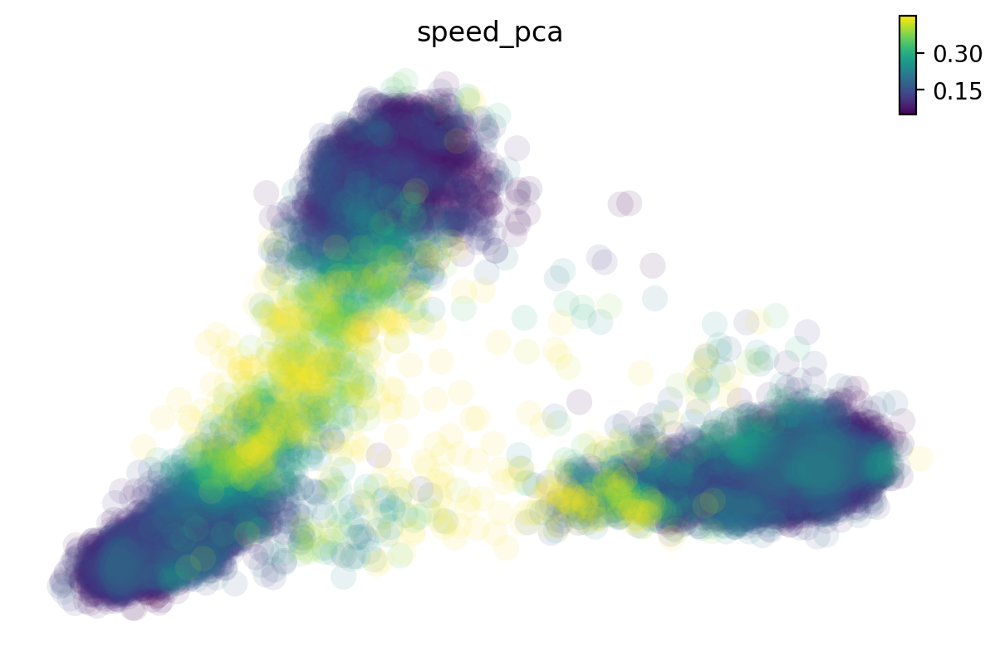

In [63]:
dyn.pl.scatters(
    adata,
    basis="pca",
    color="speed_pca",    # continuous values
    cmap="viridis",
    background="white"
)

|-----------> plotting with basis key=X_pca


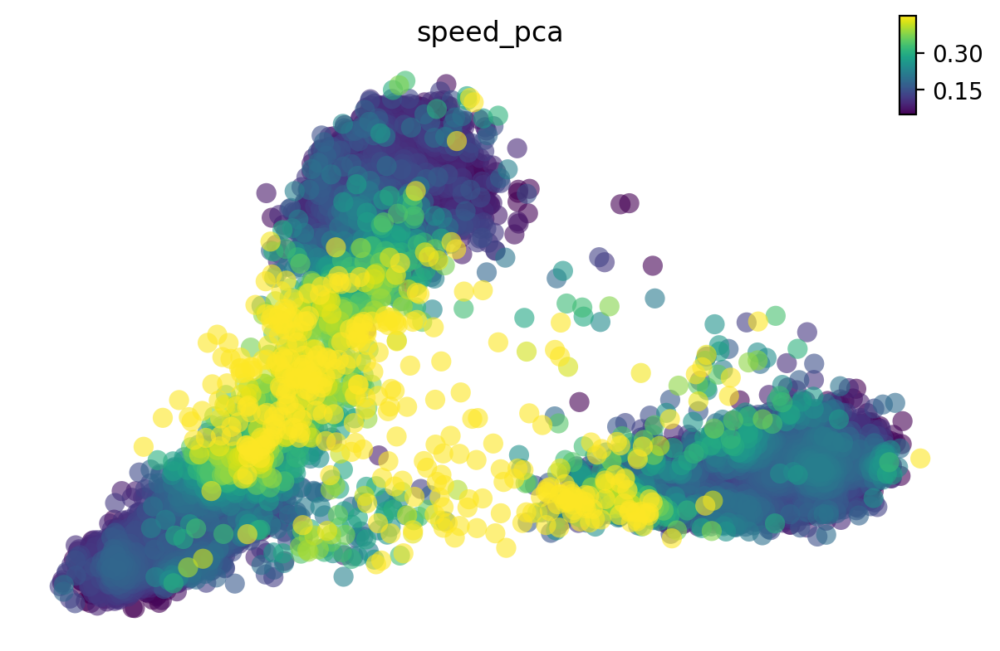

In [123]:
dyn.pl.scatters(
    adata,
    basis="pca",
    color="speed_pca",
    cmap="viridis",
    background="white",
    alpha=0.6,
    edgecolor="black",   # outline color
    facecolors="none",   # hollow circles
    linewidth=0,       # thin outline
    pointsize=0.6          # adjust as needed
)

|-----------> plotting with basis key=X_pca


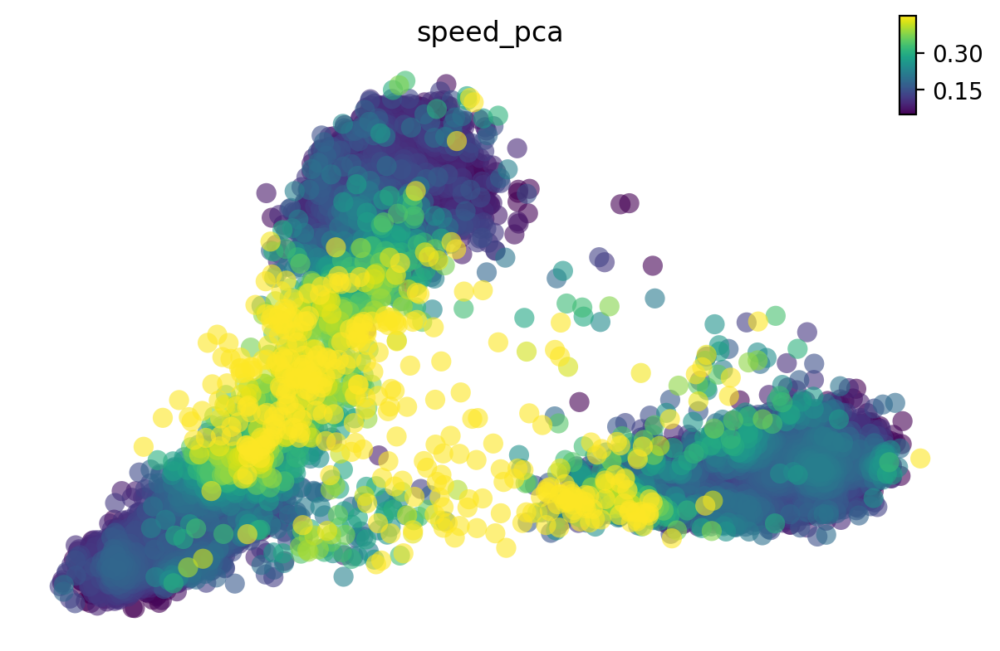

AttributeError: 'NoneType' object has no attribute 'axes'

In [64]:
fig = dyn.pl.scatters(
    adata,
    basis="pca",
    color="speed_pca",
    cmap="viridis",
    background="white",
    alpha=0.6,
    edgecolor="black",   # outline color
    facecolors="none",   # hollow circles
    linewidth=0,       # thin outline
    pointsize=0.6          # adjust as needed
)

# 2) (Optional but recommended) rasterize heavy artists to slim the PDF
ax = fig.axes[0]
for coll in ax.collections:
    if isinstance(coll, mcoll.PathCollection):
        coll.set_rasterized(True)

# 3) Export as PDF (vector axes + rasterized points)
#fig.savefig(
 #   "PCA_speed_pca.pdf",
 #   bbox_inches="tight",
  #  dpi=300,            # affects rasterized points resolution
  #  transparent=False   # set True if you want a transparent background
#)
plt.close(fig)

In [126]:
import matplotlib.pyplot as plt
from matplotlib import collections as mcoll

# make sure speed_pca exists
if "speed_pca" not in adata.obs:
    dyn.vf.speed(adata, basis="pca")

# call scatters
ax = dyn.pl.scatters(
    adata,
    basis="pca",
    color="speed_pca",
    cmap="viridis",
    background="white",
    pointsize=0.6,
    alpha=1.0,
    show_legend=False,
    save_show_or_return="return"   # returns Axes
)

# get the parent Figure
fig = ax.get_figure()

# rasterize point cloud (keep axes/text as vector)
for coll in ax.collections:
    if isinstance(coll, mcoll.PathCollection):
        coll.set_rasterized(True)

# save as PDF
fig.savefig(
    "PCA_speed_pca.pdf",
    bbox_inches="tight",
    dpi=300,
    transparent=False
)
plt.close(fig)

|-----------> plotting with basis key=X_pca


# Data split by sample

In [65]:
print(adata.obs["sample"].unique())

['CTL', 'ER_Pik', 'Kit_Pik']
Categories (3, object): ['CTL', 'ER_Pik', 'Kit_Pik']


In [67]:
# Filteration of specific sample
adata_sub = adata[adata.obs["sample"] == "ER_Pik"].copy()

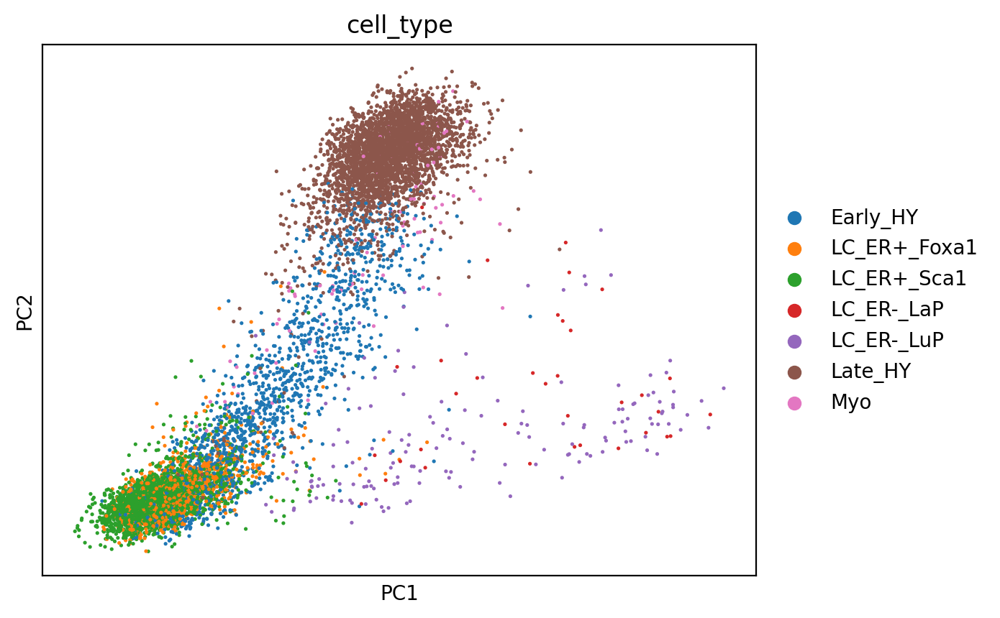

In [68]:
sc.pl.pca(adata_sub, color='cell_type')

|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


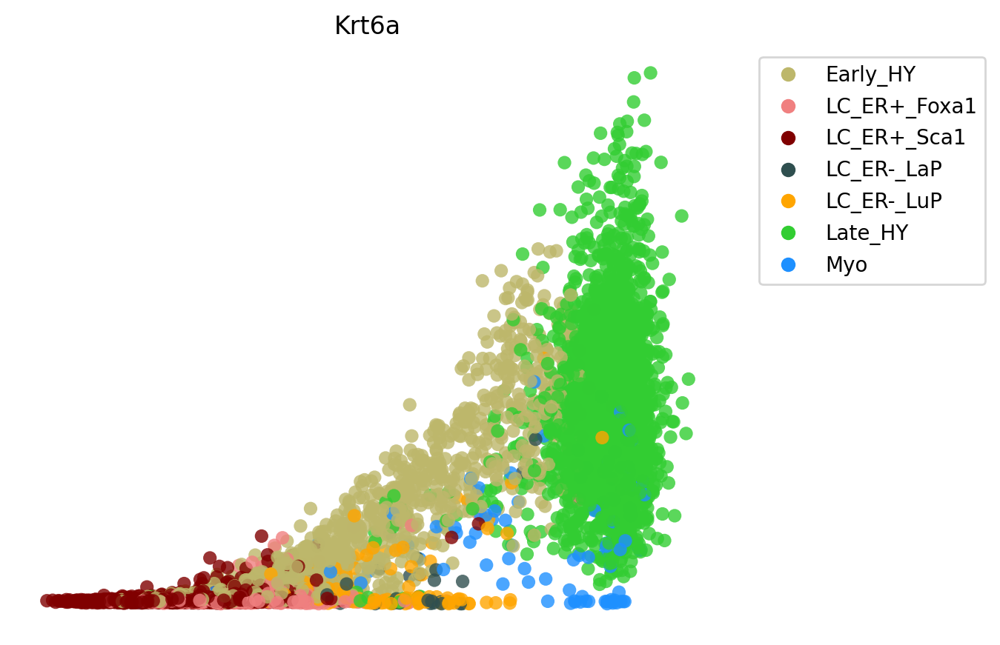

In [69]:
# build dict with only categories that exist in your data
cats = list(adata_sub.obs["cell_type"].cat.categories)
color_key = {ct: celltype_colors[ct] for ct in cats if ct in celltype_colors}

fig, ax = plt.subplots(figsize=(6, 5))
dyn.pl.scatters(
    adata_sub,
    x="pca_ddhodge_potential",
    y="Krt6a",                # single gene
    layer="X_spliced",
    color="cell_type",
    pointsize=0.25,
    alpha=0.8,
    basis="pca",
    background="white",
    ax=ax,
    show_legend="None",
    save_show_or_return="show",
    color_key=color_key       # <--- apply your custom colors here
)

fig.savefig("Krt6a_scatter_customcolor_ERPik.pdf", bbox_inches="tight", dpi=300)
plt.show()

In [75]:
dyn.pl.phase_portraits(
    adata_sub,
    genes="Il33",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    save_show_or_return = "save",
    save_kwargs={"path": "./", "prefix": "Il33_phase_ERPik", "dpi": 300, "ext": "pdf"}
)

Saving figure to ./Il33_phase_ERPik_dyn_savefig.pdf...
Done


In [74]:
dyn.pl.phase_portraits(
    adata_sub,
    genes="Klf5",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    save_show_or_return = "save",
    save_kwargs={"path": "./", "prefix": "Klf5_phase_ERPik", "dpi": 300, "ext": "pdf"}
)

Saving figure to ./Klf5_phase_ERPik_dyn_savefig.pdf...
Done


In [76]:
# Filteration of specific sample
adata_ctl = adata[adata.obs["sample"] == "CTL"].copy()

In [78]:
# build dict with only categories that exist in your data
cats = list(adata_ctl.obs["cell_type"].cat.categories)
color_key = {ct: celltype_colors[ct] for ct in cats if ct in celltype_colors}

color_key

{'LC_ER+_Foxa1': '#F08080',
 'LC_ER+_Sca1': '#800000',
 'LC_ER-_LaP': '#2F4F4F',
 'LC_ER-_LuP': '#FFA500',
 'Myo': '#1E90FF'}

|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


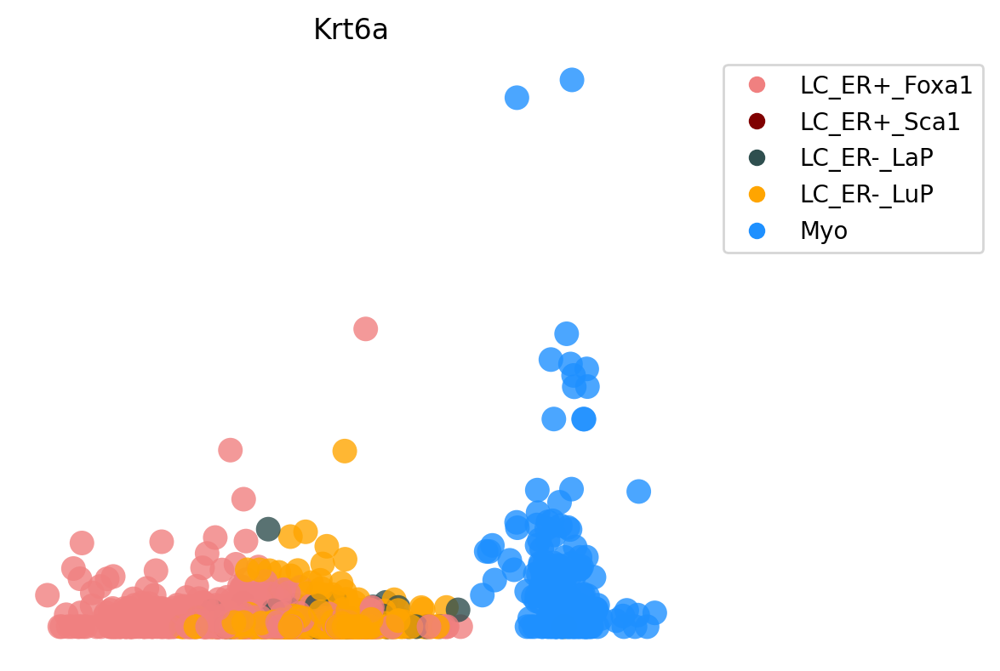

In [79]:
fig, ax = plt.subplots(figsize=(6, 5))
dyn.pl.scatters(
    adata_ctl,
    x="pca_ddhodge_potential",
    y="Krt6a",                # single gene
    layer="X_spliced",
    color="cell_type",
    pointsize=0.25,
    alpha=0.8,
    basis="pca",
    background="white",
    ax=ax,
    show_legend="None",
    save_show_or_return="show",
    color_key=color_key       # <--- apply your custom colors here
)

fig.savefig("Krt6a_scatter_customcolor_CTL.pdf", bbox_inches="tight", dpi=300)
plt.show()

In [80]:
dyn.pl.phase_portraits(
    adata_ctl,
    genes="Il33",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    save_show_or_return = "save",
    save_kwargs={"path": "./", "prefix": "Il33_phase_CTL", "dpi": 300, "ext": "pdf"}
)

Saving figure to ./Il33_phase_CTL_dyn_savefig.pdf...
Done


In [81]:
dyn.pl.phase_portraits(
    adata_ctl,
    genes="Klf5",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    save_show_or_return = "save",
    save_kwargs={"path": "./", "prefix": "Klf5_phase_CTL", "dpi": 300, "ext": "pdf"}
)

Saving figure to ./Klf5_phase_CTL_dyn_savefig.pdf...
Done


In [89]:
# Filteration of specific sample
adata_kit = adata[adata.obs["sample"] == "Kit_Pik"].copy()

In [90]:
keep_types = ["LC_ER-_LaP", "LC_ER-_LuP", "Myo"]
adata_kit = adata_kit[adata_kit.obs["cell_type"].isin(keep_types)].copy()
print(adata_kit.obs["cell_type"].unique())

['LC_ER-_LaP', 'LC_ER-_LuP', 'Myo']
Categories (3, object): ['LC_ER-_LaP', 'LC_ER-_LuP', 'Myo']


In [91]:
# build dict with only categories that exist in your data
cats = list(adata_kit.obs["cell_type"].cat.categories)
color_key = {ct: celltype_colors[ct] for ct in cats if ct in celltype_colors}

color_key

{'LC_ER-_LaP': '#2F4F4F', 'LC_ER-_LuP': '#FFA500', 'Myo': '#1E90FF'}

|-----------> plotting with basis key=X_pca
|-----------> skip filtering cell_type by stack threshold when stacking color because it is not a numeric type


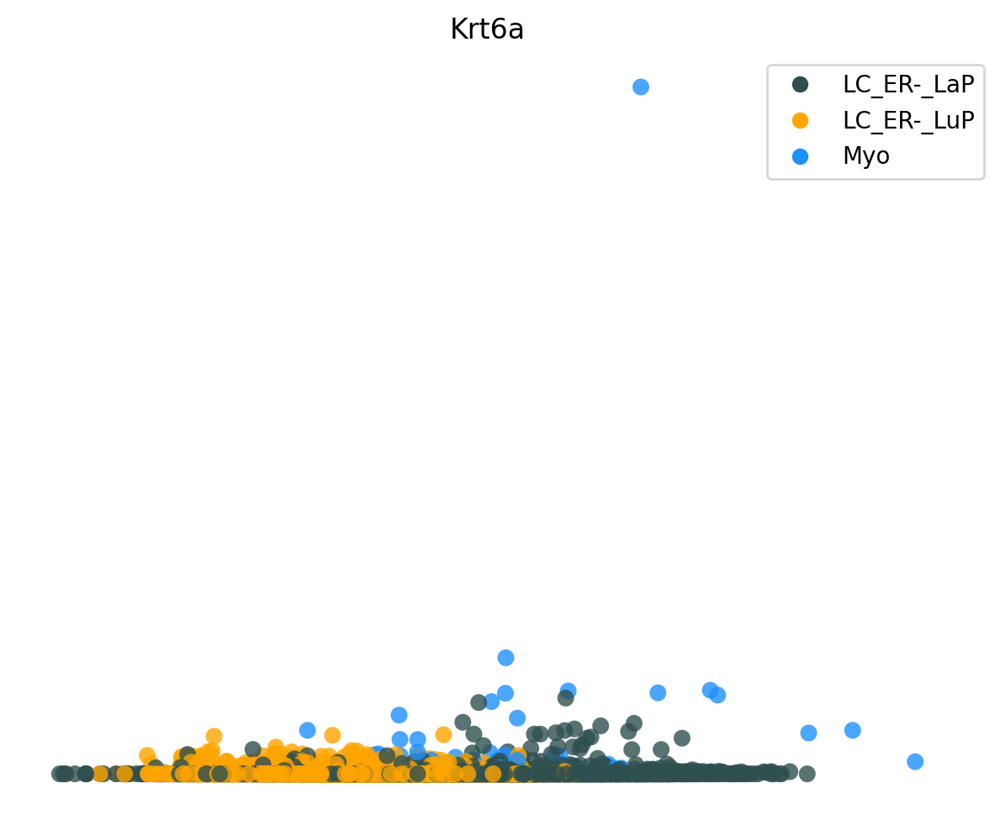

In [92]:
fig, ax = plt.subplots(figsize=(6, 5))
dyn.pl.scatters(
    adata_kit,
    x="pca_ddhodge_potential",
    y="Krt6a",                # single gene
    layer="X_spliced",
    color="cell_type",
    pointsize=0.25,
    alpha=0.8,
    basis="pca",
    background="white",
    ax=ax,
    show_legend="None",
    save_show_or_return="show",
    color_key=color_key       # <--- apply your custom colors here
)

fig.savefig("Krt6a_scatter_customcolor_KitPik.pdf", bbox_inches="tight", dpi=300)
plt.show()

In [94]:
dyn.pl.phase_portraits(
    adata_kit,
    genes="Il33",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    save_show_or_return = "save",
    save_kwargs={"path": "./", "prefix": "Il33_phase_KitPik", "dpi": 300, "ext": "pdf"}
)

Saving figure to ./Il33_phase_KitPik_dyn_savefig.pdf...
Done


In [95]:
dyn.pl.phase_portraits(
    adata_kit,
    genes="Klf5",
    color="cell_type",      # categorical
    basis="pca",
    figsize=(6, 4),

    # 3 slots: [categorical, continuous, divergent]
    discrete_continous_div_color_key=[color_key, None, None],
    # (optional) also pass 3 slots for key cmaps to silence any indexing:
    discrete_continous_div_color_key_cmap=[None, None, None],

    legend="right",
    background="white",
    save_show_or_return = "save",
    save_kwargs={"path": "./", "prefix": "Klf5_phase_KitPik", "dpi": 300, "ext": "pdf"}
)

Saving figure to ./Klf5_phase_KitPik_dyn_savefig.pdf...
Done
